# Open University Data Analysis Workshop Project

Served by:
Itay Cohen - 209146158
Alon Gilda - 209146224

## Project Goal

The goal of this project is to give us users a better way to plan their trips using public transportation.
 
Often times when we plan a trip using public transportation and we count on the timings specified by the public transportation companies, we find ourselves waiting for the bus for a long time, or even worse, missing the bus and having to wait for the next one.

This project aims to solve this problem by using real-time data to predict the arrival time of the bus to the station, and to give the user a better estimation of the arrival time of the bus to the station.

## Motivation

We both live outside of Tel Aviv and have a long commute to work.

We prefer to relay on public transportation rather than driving to work.

Current applications and methods in Israel are far from accurate. We find ourselves not trusting the applications and prefer to use our own estimations based on our personal experience.

We believe that we can use the data that is available to us to create a better estimation of the arrival time of the bus to the station.




# Data sources - overview

There is a lot of data around public transportation methods, most of it relies on government source.

These sources listed below, are what we found best to describe the data we need to create our model. 

### GTFS

GTFS is a standard format for public transportation data. It is used by many public transportation companies around the world.

In Israel, GTFS data is being published in government websites, as long with some other private archives.
 
You can find here a detailed example of what GTFS data looks like:

[https://transitfeeds.com/p/ministry-of-transport-and-road-safety/820/latest/routes](https://transitfeeds.com/p/ministry-of-transport-and-road-safety/820/latest/routes)

*GTFS Data only contains planned data, and does not contain real-time data.*

### SIRI (Real time data)

SIRI Data is the Israeli government name for it's real-time bus API.

It's being published by a specific API upon request, and gives the opportunity to log real time data.

[https://www.gov.il/he/departments/general/real_time_information_siri](https://www.gov.il/he/departments/general/real_time_information_siri)

### Hasadna - Open Bus

Hasadna is a non-profit organization, based on volunteers, that collects data from the Israeli government and publishes it to the public.


Open Bus is a project by Hasadna that collects data from the SIRI API and publishes it to the public.

They log the data into servers and allow querying it via an API called Stride.

Hasadna Site : [www.hasadna.org.il](www.hasadna.org.il)


### Install dependencies

This notebook requires two dependencies which can be installed with the following command `pip install pandas open-bus-stride-client`.
Make sure to use pandas version 1.4.3

In [37]:
import pandas as pd
import math
import stride
import plotly.express as px
import seaborn as sns
import os
import datetime
import networkx as nx
from datetime import timedelta
import random
from IPython.display import display

# Data Collection

Utilize the Stride API to collect data and explain the data we collected.

The input we use is line numbers. I live close by to line 123, and Itay lives close by to line 202.

The data displayed below is the first query in order to generate the official 'line_ref' and 'operator_ref', which are a more official version of the line number.


The data we collected from the gtft_routes/list endpoint is the following:
For each transportation company, we have a unique operator_ref. for example 3 stands for Egged.
Then each route number there is the route_short_name, which is the line number, and the line_ref, which is the official line number.
In order to know what is the overall direction of the line, we have the line_ref. Together with the operator_ref, we can understand the line number and the direction of the line.
The route_mkt is a unique 5-digit number at the line level. 
The route_type is the type of transportation, for example, 3 stands for bus, 2 train and 0 is light rail.



In [38]:
display(pd.DataFrame(stride.iterate('/gtfs_routes/list', {"route_short_name": "123", "limit": 3}, limit=3)))


,id,date,line_ref,operator_ref,route_short_name,route_long_name,route_mkt,route_direction,route_alternative,agency_name,route_type
0,997,2022-03-14,4134,3,123,ת. מרכזית חוף הכרמל/רציפים עירוני-חיפה<->ת. מר...,10123,1,#,אגד,3
1,998,2022-03-14,4135,3,123,ת. מרכזית המפרץ/רציפים עירוני-חיפה<->ת. מרכזית...,10123,2,#,אגד,3
2,1306,2022-03-14,6529,4,123,המרפא-ירושלים<->תלמוד תורה/דרך קדם-מעלה אדומים-1#,11123,1,#,אגד תעבורה,3


### Siri rides

After getting the official line name, we collect data about the rides that we're done in that day.

We'll show here a specific example for a operator ref + line ref

Each bus ride has a special ID to it.

The query needs to have a short time frame or else it will take a long time to run.

In the SIRI data we get the real time data.
Each ride have a unique identifier called journey_ref that is provided by the original MOT GTRF data.
Like the juurney_ref we have vehicle_ref that is the vehicle unique identifier (the most common is the license plate number).
We can know when was the scheduled start time,the duration of the ride in minutes the first and last location id of the ride and more.
As for all the gtfs_route__{some field}, it is the same data explained in the GTFS section.



In [39]:
display(pd.DataFrame(stride.iterate('/siri_rides/list', {
            "gtfs_ride__start_time_from": '2023-08-01T00:00:00+03:00',
            "scheduled_start_time_from": '2023-08-01T00:00:00+03:00',
            "gtfs_ride__start_time_to": '2023-08-02T00:00:00+03:00',
            "scheduled_start_time_to": '2023-08-02T00:00:00+03:00',
            "gtfs_route__line_refs": "4135",
            "limit": 3
        }, limit = 3)))

,id,siri_route_id,journey_ref,scheduled_start_time,vehicle_ref,updated_first_last_vehicle_locations,first_vehicle_location_id,last_vehicle_location_id,updated_duration_minutes,duration_minutes,...,gtfs_route__date,gtfs_route__line_ref,gtfs_route__operator_ref,gtfs_route__route_short_name,gtfs_route__route_long_name,gtfs_route__route_mkt,gtfs_route__route_direction,gtfs_route__route_alternative,gtfs_route__agency_name,gtfs_route__route_type
0,45186667,1851,2023-08-01-47514084,2023-08-01 01:48:00+00:00,23298702,2023-08-01 02:48:10.381392+00:00,2419652557,2419671361,2023-08-01 09:50:08.291724+00:00,38,...,2023-08-01,4135,3,123,ת. מרכזית המפרץ/רציפים עירוני-חיפה<->ת. מרכזית...,10123,2,#,אגד,3
1,45194056,1851,2023-08-01-46050026,2023-08-01 03:38:00+00:00,23316202,2023-08-01 04:51:26.668576+00:00,2419873682,2420159075,2023-08-01 12:52:54.580704+00:00,53,...,2023-08-01,4135,3,123,ת. מרכזית המפרץ/רציפים עירוני-חיפה<->ת. מרכזית...,10123,2,#,אגד,3
2,45197636,1851,2023-08-01-57498150,2023-08-01 04:02:00+00:00,7534669,2023-08-01 05:11:08.322010+00:00,2420017461,2420330647,2023-08-01 13:01:04.033183+00:00,51,...,2023-08-01,4135,3,123,ת. מרכזית המפרץ/רציפים עירוני-חיפה<->ת. מרכזית...,10123,2,#,אגד,3


### Siri ride stops

We want to create predictions per station of the ride.

We take each ride and query the stops that were made in that ride.

Each stop bus station, light train station and mote gets a unique identifier called siri_stop_id.
Same as the SIRI the GTF have its own unique identifier called gtfs_stop_id. with the stop code, name, city and more.
The stop code is the same number we can see in the bus station.
The position of the order in the ride path is explained in the order column, where 0 is the first stop.
The nearest_siri_vehicle_location_id stands for the nearest vehicle location from this ride to the stop.
In general all the fields with th nearest_siri_vehicle_location__{some field} holds information about the nearest vehicle location to the stop,
with the relevant route.
The information we can find is the geolocation location of the vehicle, recorded time, direction, speed, distance from the beginning of the ride and from the end of the ride.
Another interesting field is the nearest_siri_vehicle_location__distance_from_siri_ride_stop_meters that holds the distance from the vehicle to the stop in meters.

As for all the siri_ride__{some field}, it is the same data explained in the SIRI ride section.
As for all the gtfs_route__{some field}, it is the same data explained in the GTFS section.


In [40]:
display(pd.DataFrame(stride.iterate('/siri_ride_stops/list', {
            "siri_ride_ids": "45194056",
            "siri_ride__scheduled_start_time_from": '2023-08-01T00:00:00+03:00',
            "siri_ride__scheduled_start_time_to": '2023-08-02T00:00:00+03:00',
            "limit": 3
        }, limit=3)))

,id,siri_stop_id,siri_ride_id,order,gtfs_stop_id,nearest_siri_vehicle_location_id,siri_stop__code,siri_ride__siri_route_id,siri_ride__journey_ref,siri_ride__scheduled_start_time,...,gtfs_route__date,gtfs_route__line_ref,gtfs_route__operator_ref,gtfs_route__route_short_name,gtfs_route__route_long_name,gtfs_route__route_mkt,gtfs_route__route_direction,gtfs_route__route_alternative,gtfs_route__agency_name,gtfs_route__route_type
0,1177716658,5755,45194056,33,15785704,2420159075,42656,1851,2023-08-01-46050026,2023-08-01 03:38:00+00:00,...,2023-08-01,4135,3,123,ת. מרכזית המפרץ/רציפים עירוני-חיפה<->ת. מרכזית...,10123,2,#,אגד,3
1,1177710610,3504,45194056,32,15785597,2420146796,42506,1851,2023-08-01-46050026,2023-08-01 03:38:00+00:00,...,2023-08-01,4135,3,123,ת. מרכזית המפרץ/רציפים עירוני-חיפה<->ת. מרכזית...,10123,2,#,אגד,3
2,1177704517,9292,45194056,31,15785830,2420134944,42825,1851,2023-08-01-46050026,2023-08-01 03:38:00+00:00,...,2023-08-01,4135,3,123,ת. מרכזית המפרץ/רציפים עירוני-חיפה<->ת. מרכזית...,10123,2,#,אגד,3


### DataFetcher class - finalized data collection

In [41]:

lines = [123, 202, 921, 970, 148, 55, 82, 17, 18, 138, 70]
TIME_PERIOD_TRAIN = {
    'start': '2022-06-01T00:00:00+03:00',
    'end': '2022-07-01T00:00:00+03:00'
}

TIME_PERIOD_TEST = {
    'start': '2023-06-01T00:00:00+03:00',
    'end': '2023-07-01T00:00:00+03:00'
}


In [42]:
import stride
import pandas as pd
import os
import re
import datetime
from datetime import timedelta
import random

DATA_DIR = "data"
class DataFetcher(object):
    def __init__(self,
                 name,
                 lines,
                 start_date,
                 end_date,
                 time_period_per_sample_hop_in_days = 1,
                 amount_of_lines_to_sample_per_hop = 5,
                 limit_ratio_lines_to_gtfs_lines = 5,
                 amount_of_rides_to_sample_per_hop = 100,
                 limit_routes_per_single_day = 10000,
                 limit_stops_per_single_day = 100000
                 ):
        self.start_date = start_date
        self.end_date = end_date
        self.time_period_per_sample_hop_in_days = time_period_per_sample_hop_in_days
        self.amount_of_lines_to_sample_per_hop = amount_of_lines_to_sample_per_hop
        self.limit_ratio_lines_to_gtfs_lines = limit_ratio_lines_to_gtfs_lines
        self.limit_routes_per_single_day = limit_routes_per_single_day
        self.limit_stops_per_single_day = limit_stops_per_single_day
        self.amount_of_rides_to_sample_per_hop = amount_of_rides_to_sample_per_hop
        self.lines = lines
        self.id = f"{name}_{start_date}_{end_date}"

    def fetch(self):
        # Check if data already exists
        final_data_path = f"{DATA_DIR}/{self.id}_final_data.csv"
        if os.path.exists(final_data_path):
            return pd.read_csv(final_data_path)

        # Fetch data
        self.data = self.fetch_loop()
        # Save data
        self.cache_table(self.data, "final_data")
        return self.data


    def get_time_periods(self):
        time_periods = []
        # Time example - 2023-08-01T00:00:00+03:00
        start_time_as_datetime = datetime.datetime.strptime(self.start_date, "%Y-%m-%dT%H:%M:%S%z")
        end_time_as_datetime = datetime.datetime.strptime(self.end_date, "%Y-%m-%dT%H:%M:%S%z")

        current_time = start_time_as_datetime
        while current_time < end_time_as_datetime:
            current_time_as_str = current_time.strftime("%Y-%m-%dT%H:%M:%S%z")
            next_time = current_time + timedelta(days=self.time_period_per_sample_hop_in_days)
            next_time_as_str = next_time.strftime("%Y-%m-%dT%H:%M:%S%z")
            time_periods.append((current_time_as_str, next_time_as_str))
            current_time = next_time

        return time_periods
    def fetch_loop(self):
        # One time convert lines to gtfs lines
        self.gtfs_lines = self.convert_lines_to_gtfs_lines()
        self.lines_refs_unq = self.gtfs_lines['line_ref'].unique()

        full_siri_ride_stops = pd.DataFrame()
        for start_time_as_str, end_time_as_str in self.get_time_periods():
            print(f"Fetching data for time period: {start_time_as_str} - {end_time_as_str}")
            siri_ride_stops_daily = self.fetch_single_time_period(start_time_as_str, end_time_as_str)
            if siri_ride_stops_daily is None or siri_ride_stops_daily.empty:
                continue
            full_siri_ride_stops = pd.concat([full_siri_ride_stops, siri_ride_stops_daily])

        return full_siri_ride_stops

    def fetch_single_time_period(self, start_time_str, end_time_str):
        # Randomly select lines refs to sample
        sampled_line_refs = random.sample(list(self.lines_refs_unq), self.amount_of_lines_to_sample_per_hop)
        print(f"Sampled line refs: {sampled_line_refs}")
        # Get rides for those lines
        siri_rides = self.read_siri_rides(sampled_line_refs, start_time_str, end_time_str)
        # return if siri rides is empty
        if siri_rides.empty:
            return pd.DataFrame()
        siri_ride_ids_unq = siri_rides['id'].unique()
        # Get stops for those rides
        siri_ride_stops = self.read_siri_ride_stops(siri_ride_ids_unq, start_time_str, end_time_str)
        return siri_ride_stops

    def convert_lines_to_gtfs_lines(self):
        cached_data = self.read_cached_table("lines_data")
        if cached_data is not None:
            return cached_data

        lines_data = pd.DataFrame()

        # Iterate each line and append to the lines_data dataframe
        for line in self.lines:
            new_line_by_short_name = pd.DataFrame(
                stride.iterate('/gtfs_routes/list', {"route_short_name": line, "limit": 5}, limit=5))

            lines_data = pd.concat([lines_data, new_line_by_short_name])

        self.cache_table(lines_data, "lines_data")
        return lines_data

    def read_siri_rides(self, line_refs_unq, start_time_str, end_time_str):
        table_name = f"siri_rides_{start_time_str}_{end_time_str}"
        cached_data = self.read_cached_table(table_name)
        if cached_data is not None:
            return cached_data

        # Get GTFS Data
        siri_rides = pd.DataFrame(stride.iterate('/siri_rides/list', {
            "gtfs_ride__start_time_from": start_time_str,
            "scheduled_start_time_from": start_time_str,
            "gtfs_ride__start_time_to": end_time_str,
            "scheduled_start_time_to": end_time_str,
            "gtfs_route__line_refs": ",".join([str(line_ref) for line_ref in line_refs_unq]),
            "limit": self.limit_routes_per_single_day
        }, limit = self.limit_routes_per_single_day))

        self.cache_table(siri_rides, table_name)
        return siri_rides

    def read_siri_ride_stops(self, siri_ride_ids_unq, start_time_str, end_time_str):
        table_name = f"siri_ride_stops_{start_time_str}_{end_time_str}"
        cached_data = self.read_cached_table(table_name)
        if cached_data is not None:
            return cached_data

        # Randomly sample rids ids
        if len(siri_ride_ids_unq) > self.amount_of_rides_to_sample_per_hop:
            print(f"Sampling {self.amount_of_rides_to_sample_per_hop} rides out of {len(siri_ride_ids_unq)}")
            siri_ride_ids_unq = random.sample(list(siri_ride_ids_unq), self.amount_of_rides_to_sample_per_hop)

        # Get GTFS Data
        siri_ride_stops = pd.DataFrame(stride.iterate('/siri_ride_stops/list', {
            "siri_ride_ids": ",".join([str(siri_ride_id) for siri_ride_id in siri_ride_ids_unq]),
            "siri_ride__scheduled_start_time_from": start_time_str,
            "siri_ride__scheduled_start_time_to": end_time_str,
            "limit": self.limit_stops_per_single_day
        }, limit=self.limit_stops_per_single_day))

        self.cache_table(siri_ride_stops, table_name)
        return siri_ride_stops

    def cache_table(self, table, table_name):
        table.to_csv(f"{DATA_DIR}/{self.id}_{table_name}.csv")

    def read_cached_table(self, table_name):
        path = f"{DATA_DIR}/{self.id}_{table_name}.csv"
        # Check if file exists
        if not os.path.exists(path):
            return None
        table = pd.read_csv(path)
        # remove unnamed column
        table = table.loc[:, ~table.columns.str.contains('^Unnamed')]
        return table

In [43]:
data_test = DataFetcher(
    name = "single_month_prod_test_set",
    lines = lines,
    start_date = TIME_PERIOD_TEST['start'],
    end_date = TIME_PERIOD_TEST['end'],
    time_period_per_sample_hop_in_days = 1,
    amount_of_lines_to_sample_per_hop = 10,
    limit_ratio_lines_to_gtfs_lines = 5,
    amount_of_rides_to_sample_per_hop = 100,
    limit_routes_per_single_day = 1000,
    limit_stops_per_single_day = 10000
)

In [44]:
test_data = data_test.fetch()

In [45]:
train_data = DataFetcher(
    name = "single_month_prod_train_set_half_day",
    lines = lines,
    start_date = TIME_PERIOD_TRAIN['start'],
    end_date = TIME_PERIOD_TRAIN['end'],
    time_period_per_sample_hop_in_days = 0.5,
    amount_of_lines_to_sample_per_hop = 10,
    limit_ratio_lines_to_gtfs_lines = 5,
    amount_of_rides_to_sample_per_hop = 100,
    limit_routes_per_single_day = 1000,
    limit_stops_per_single_day = 10000
)

In [46]:
training_data = train_data.fetch()

# EDA - Exploratory Data Analysis

In this section we will work with our main training set to get a good understanding of the data.

The purpose of this section is to:
 
1. Get a better understanding of the data we are working with
2. Explore ideas for features
3. Data cleaning methods

In [47]:
data = training_data

In [48]:
# Calculating the percentage of missing values in each column
missing_percentage = (data.isnull().sum() / len(data)) * 100

# Displaying columns with missing values and their corresponding percentages
missing_data_summary = pd.DataFrame({'Column': missing_percentage.index, 'MissingPercentage': missing_percentage.values})
missing_data_summary = missing_data_summary[missing_data_summary.MissingPercentage > 0]
missing_data_summary.sort_values(by='MissingPercentage', ascending=False)


,Column,MissingPercentage
16,siri_ride__journey_gtfs_ride_id,75.358410
42,gtfs_ride_stop__shape_dist_traveled,14.305463
41,gtfs_ride_stop__drop_off_type,12.664946
40,gtfs_ride_stop__pickup_type,12.664946
39,gtfs_ride_stop__stop_sequence,12.664946
38,gtfs_ride_stop__departure_time,12.664946
37,gtfs_ride_stop__arrival_time,12.664946
36,gtfs_ride_stop__gtfs_ride_id,12.664946
35,gtfs_ride_stop__gtfs_stop_id,12.664946
34,nearest_siri_vehicle_location__distance_from_s...,10.407664


Our target variable is the difference between the actual arrival time and the scheduled arrival time.

This is why we need to filter our nulls for the nearest_siri_vehicle_location__siri_ride_stop_id and gtfs_ride_stop__arrival_time.

This is obviously an estimate since the exact arrival time is based on the SIRI measurements, which are being queried every other minute, approximately, according the Hasadna. 

In [49]:
data = data[data.nearest_siri_vehicle_location__siri_ride_stop_id.notnull() & data.gtfs_ride_stop__arrival_time.notnull()]

In [50]:
# Calculating the percentage of missing values in each column
missing_percentage = (data.isnull().sum() / len(data)) * 100

# Displaying columns with missing values and their corresponding percentages
missing_data_summary = pd.DataFrame({'Column': missing_percentage.index, 'MissingPercentage': missing_percentage.values})
missing_data_summary = missing_data_summary[missing_data_summary.MissingPercentage > 0]
missing_data_summary.sort_values(by='MissingPercentage', ascending=False)

,Column,MissingPercentage
16,siri_ride__journey_gtfs_ride_id,74.624696
42,gtfs_ride_stop__shape_dist_traveled,1.757520
17,siri_ride__route_gtfs_ride_id,0.029958


Great! a lot less nulls.
Let's remove the siri_ride__journey_gtfs_ride_id column from our data, as it is not relevant and has a high null percentage.
The column 

In [51]:
data = data.drop(columns=['siri_ride__journey_gtfs_ride_id'])

In [52]:
data

,Unnamed: 0,id,siri_stop_id,siri_ride_id,order,gtfs_stop_id,nearest_siri_vehicle_location_id,siri_ride__siri_route_id,siri_ride__journey_ref,siri_ride__scheduled_start_time,...,gtfs_route__date,gtfs_route__line_ref,gtfs_route__operator_ref,gtfs_route__route_short_name,gtfs_route__route_long_name,gtfs_route__route_mkt,gtfs_route__route_direction,gtfs_route__route_alternative,gtfs_route__agency_name,gtfs_route__route_type
10534,0,220827192,2824,8636477,28,2968124,454708662.0,185,2022-06-05-16670158,2022-06-05 20:05:00+00:00,...,2022-06-05,2544,5,70,בי''ח שיב''א/שדרות אהרון קציר-רמת גן<->ת.מרכזי...,20070,2,0,דן,3
10535,1,220825052,3162,8636477,27,2968481,454706030.0,185,2022-06-05-16670158,2022-06-05 20:05:00+00:00,...,2022-06-05,2544,5,70,בי''ח שיב''א/שדרות אהרון קציר-רמת גן<->ת.מרכזי...,20070,2,0,דן,3
10536,2,220823942,2358,8636477,26,2968157,454700644.0,185,2022-06-05-16670158,2022-06-05 20:05:00+00:00,...,2022-06-05,2544,5,70,בי''ח שיב''א/שדרות אהרון קציר-רמת גן<->ת.מרכזי...,20070,2,0,דן,3
10537,3,220822881,8272,8636477,25,2968076,454697919.0,185,2022-06-05-16670158,2022-06-05 20:05:00+00:00,...,2022-06-05,2544,5,70,בי''ח שיב''א/שדרות אהרון קציר-רמת גן<->ת.מרכזי...,20070,2,0,דן,3
10538,4,220821842,6946,8636477,24,2968156,454695195.0,185,2022-06-05-16670158,2022-06-05 20:05:00+00:00,...,2022-06-05,2544,5,70,בי''ח שיב''א/שדרות אהרון קציר-רמת גן<->ת.מרכזי...,20070,2,0,דן,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
103438,2839,269614904,496,10524677,6,3612329,553647899.0,706,2022-06-28-296280,2022-06-28 09:10:00+00:00,...,2022-06-28,1091,25,17,בית העלמין-ראש העין<->מסוף משה ארנס/הורדה-פתח ...,29017,2,0,אלקטרה אפיקים,3
103439,2840,269613906,28827,10525395,1,3624654,553666918.0,2365,2022-06-28-27114720,2022-06-28 09:15:00+00:00,...,2022-06-28,8199,15,55,כפר הסטודנטים/דרך יצחק שמיר-דימונה<->מרכז מסחר...,24055,2,#,מטרופולין,3
103440,2841,269612251,9906,10524677,4,3608156,553642631.0,706,2022-06-28-296280,2022-06-28 09:10:00+00:00,...,2022-06-28,1091,25,17,בית העלמין-ראש העין<->מסוף משה ארנס/הורדה-פתח ...,29017,2,0,אלקטרה אפיקים,3
103441,2842,269609495,6988,10524677,2,3608074,553637315.0,706,2022-06-28-296280,2022-06-28 09:10:00+00:00,...,2022-06-28,1091,25,17,בית העלמין-ראש העין<->מסוף משה ארנס/הורדה-פתח ...,29017,2,0,אלקטרה אפיקים,3


<Axes: >

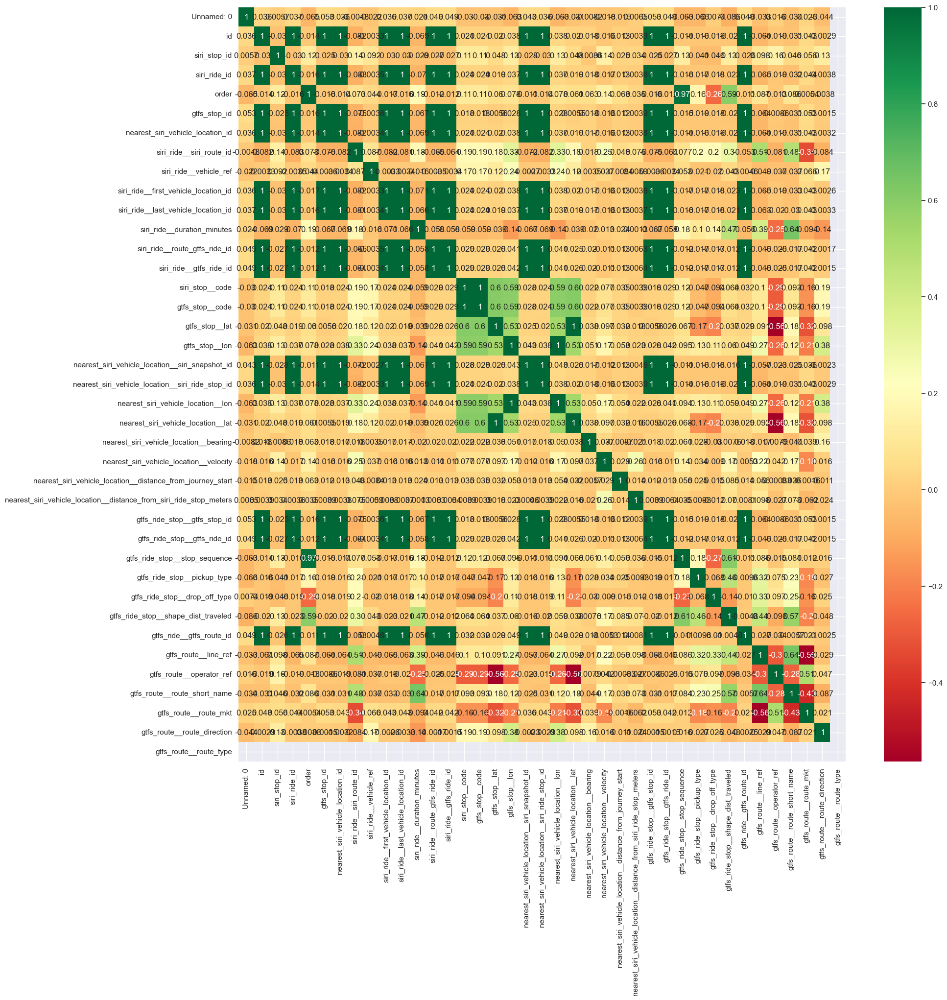

In [53]:
# Correlations between columns
corr = data.corr()

# Plot a big heatmap of the correlations
sns.set(rc={'figure.figsize': (20, 20)})
sns.heatmap(corr, annot=True, cmap="RdYlGn")


In [54]:
# Calculating correlation matrix
corr_matrix = data.corr().abs()

# Initializing a graph
G = nx.Graph()

# Adding edges between highly correlated columns
for i in range(len(corr_matrix.columns)):
    for j in range(i+1, len(corr_matrix.columns)):
        if corr_matrix.iloc[i, j] >= 0.995:  # Threshold for adding an edge
            G.add_edge(corr_matrix.columns[i], corr_matrix.columns[j])

# Finding connected components (groups of correlated columns)
connected_components = list(nx.connected_components(G))

# Initialize mappings of columns to remove and to keep
columns_to_keep = set()
replacement_mapping = {}

for group in connected_components:
    # Selecting the first column in each group to keep
    keep = next(iter(group))
    columns_to_keep.add(keep)
    # Mapping the rest for removal
    for col in group:
        if col != keep:
            replacement_mapping[col] = keep

# Removing columns that are not kept
columns_to_remove = list(set(replacement_mapping.keys()))
data = data.drop(columns=columns_to_remove)

# Print statements for replaced columns
for col, replacement in replacement_mapping.items():
    print(f"Removed column: {col}, replaced with: {replacement}")


Removed column: gtfs_ride_stop__gtfs_stop_id, replaced with: id
Removed column: gtfs_stop_id, replaced with: id
Removed column: siri_ride__first_vehicle_location_id, replaced with: id
Removed column: siri_ride__gtfs_ride_id, replaced with: id
Removed column: nearest_siri_vehicle_location__siri_ride_stop_id, replaced with: id
Removed column: siri_ride_id, replaced with: id
Removed column: gtfs_ride_stop__gtfs_ride_id, replaced with: id
Removed column: siri_ride__route_gtfs_ride_id, replaced with: id
Removed column: gtfs_ride__gtfs_route_id, replaced with: id
Removed column: nearest_siri_vehicle_location__siri_snapshot_id, replaced with: id
Removed column: nearest_siri_vehicle_location_id, replaced with: id
Removed column: siri_ride__last_vehicle_location_id, replaced with: id
Removed column: siri_stop__code, replaced with: gtfs_stop__code
Removed column: gtfs_stop__lat, replaced with: nearest_siri_vehicle_location__lat
Removed column: nearest_siri_vehicle_location__lon, replaced with: g

In [55]:
data

,Unnamed: 0,id,siri_stop_id,order,siri_ride__siri_route_id,siri_ride__journey_ref,siri_ride__scheduled_start_time,siri_ride__vehicle_ref,siri_ride__updated_first_last_vehicle_locations,siri_ride__updated_duration_minutes,...,gtfs_route__date,gtfs_route__line_ref,gtfs_route__operator_ref,gtfs_route__route_short_name,gtfs_route__route_long_name,gtfs_route__route_mkt,gtfs_route__route_direction,gtfs_route__route_alternative,gtfs_route__agency_name,gtfs_route__route_type
10534,0,220827192,2824,28,185,2022-06-05-16670158,2022-06-05 20:05:00+00:00,9268201,2022-06-05 21:00:28.528234+00:00,2022-06-06 03:00:19.516562+00:00,...,2022-06-05,2544,5,70,בי''ח שיב''א/שדרות אהרון קציר-רמת גן<->ת.מרכזי...,20070,2,0,דן,3
10535,1,220825052,3162,27,185,2022-06-05-16670158,2022-06-05 20:05:00+00:00,9268201,2022-06-05 21:00:28.528234+00:00,2022-06-06 03:00:19.516562+00:00,...,2022-06-05,2544,5,70,בי''ח שיב''א/שדרות אהרון קציר-רמת גן<->ת.מרכזי...,20070,2,0,דן,3
10536,2,220823942,2358,26,185,2022-06-05-16670158,2022-06-05 20:05:00+00:00,9268201,2022-06-05 21:00:28.528234+00:00,2022-06-06 03:00:19.516562+00:00,...,2022-06-05,2544,5,70,בי''ח שיב''א/שדרות אהרון קציר-רמת גן<->ת.מרכזי...,20070,2,0,דן,3
10537,3,220822881,8272,25,185,2022-06-05-16670158,2022-06-05 20:05:00+00:00,9268201,2022-06-05 21:00:28.528234+00:00,2022-06-06 03:00:19.516562+00:00,...,2022-06-05,2544,5,70,בי''ח שיב''א/שדרות אהרון קציר-רמת גן<->ת.מרכזי...,20070,2,0,דן,3
10538,4,220821842,6946,24,185,2022-06-05-16670158,2022-06-05 20:05:00+00:00,9268201,2022-06-05 21:00:28.528234+00:00,2022-06-06 03:00:19.516562+00:00,...,2022-06-05,2544,5,70,בי''ח שיב''א/שדרות אהרון קציר-רמת גן<->ת.מרכזי...,20070,2,0,דן,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
103438,2839,269614904,496,6,706,2022-06-28-296280,2022-06-28 09:10:00+00:00,9003958,2022-06-28 10:01:24.950466+00:00,2022-06-28 16:00:15.442752+00:00,...,2022-06-28,1091,25,17,בית העלמין-ראש העין<->מסוף משה ארנס/הורדה-פתח ...,29017,2,0,אלקטרה אפיקים,3
103439,2840,269613906,28827,1,2365,2022-06-28-27114720,2022-06-28 09:15:00+00:00,7269152,2022-06-28 11:02:53.898998+00:00,2022-06-28 17:00:24.547968+00:00,...,2022-06-28,8199,15,55,כפר הסטודנטים/דרך יצחק שמיר-דימונה<->מרכז מסחר...,24055,2,#,מטרופולין,3
103440,2841,269612251,9906,4,706,2022-06-28-296280,2022-06-28 09:10:00+00:00,9003958,2022-06-28 10:01:24.950466+00:00,2022-06-28 16:00:15.442752+00:00,...,2022-06-28,1091,25,17,בית העלמין-ראש העין<->מסוף משה ארנס/הורדה-פתח ...,29017,2,0,אלקטרה אפיקים,3
103441,2842,269609495,6988,2,706,2022-06-28-296280,2022-06-28 09:10:00+00:00,9003958,2022-06-28 10:01:24.950466+00:00,2022-06-28 16:00:15.442752+00:00,...,2022-06-28,1091,25,17,בית העלמין-ראש העין<->מסוף משה ארנס/הורדה-פתח ...,29017,2,0,אלקטרה אפיקים,3


<Axes: >

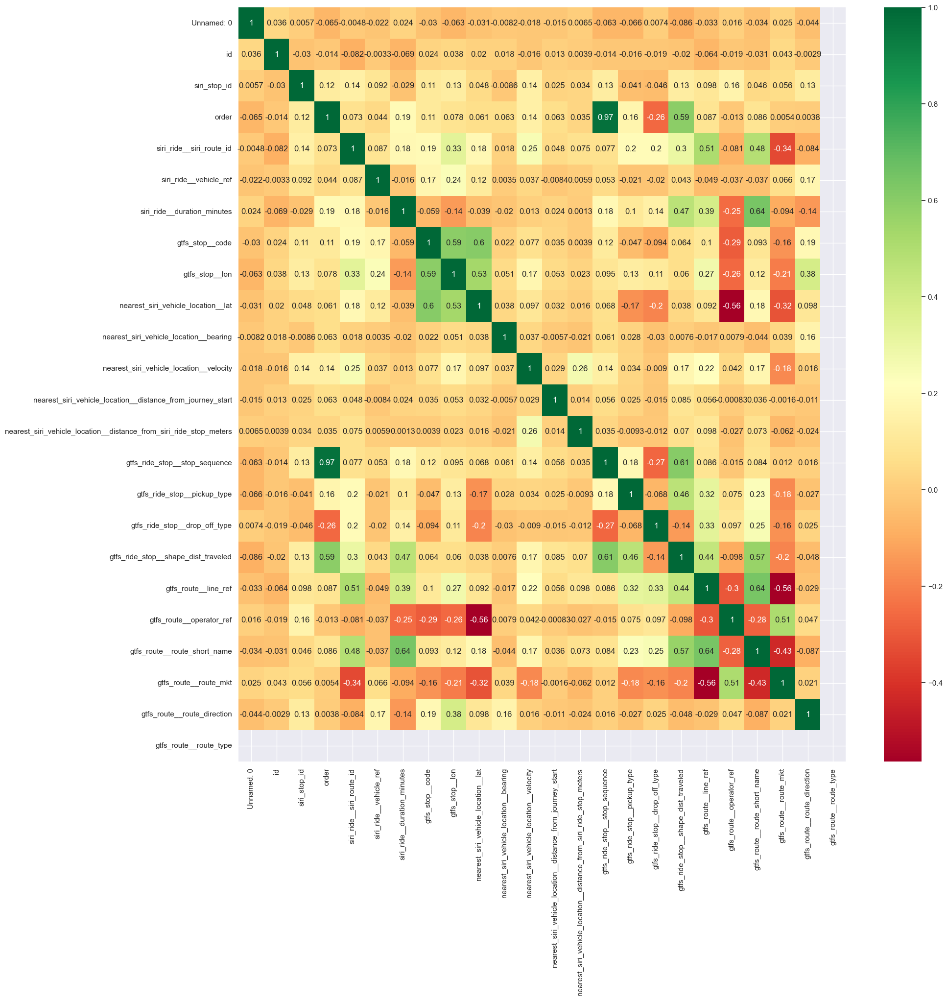

In [56]:
corr = data.corr()

# Plot a big heatmap of the correlations
sns.set(rc={'figure.figsize': (20, 20)})
sns.heatmap(corr, annot=True, cmap="RdYlGn")


In [57]:
# Convert wanted columns to datetime
data['date_time'] = pd.to_datetime(data['gtfs_ride_stop__arrival_time'])


### The model prediction target
The target of our model is the difference between the actual arrival time and the scheduled arrival time.
We cant take the expected time of arrival from the GTFS data.
We will use the nearest_siri_vehicle_location__recorded_at_time as the actual arrival time.
From the difference between the two times we can learn the actual time of arrival.

In [58]:
# Create the target variable
data["nearest_siri_vehicle_location__recorded_at_time"] = pd.to_datetime(data["nearest_siri_vehicle_location__recorded_at_time"]).dt.tz_localize(None)
data["gtfs_ride_stop__arrival_time"] = pd.to_datetime(data["gtfs_ride_stop__arrival_time"]).dt.tz_localize(None)
data["scheduled_vs_real_time_difference"] = data["nearest_siri_vehicle_location__recorded_at_time"] - data["gtfs_ride_stop__arrival_time"]
data["scheduled_vs_real_time_difference_seconds"] = data["scheduled_vs_real_time_difference"].dt.total_seconds()
data = data.sort_values(by='date_time')
# Displaying the target variable in box plot when the x is the hour of the day 
fig = px.box(data, x=data['date_time'].dt.hour, y='scheduled_vs_real_time_difference_seconds', title='Scheduled vs. Real Time Difference')
fig.show()


## Outliers
We can see that there are some outliers in the data.
We will remove the outliers from the data.

In [59]:
data = data.sort_values(by='date_time')
data = data[(data['scheduled_vs_real_time_difference_seconds'] < 1000) & (data['scheduled_vs_real_time_difference_seconds'] > -1000)]
fig = px.box(data, x=data['date_time'].dt.hour, y='scheduled_vs_real_time_difference_seconds', title='Scheduled vs. Real Time Difference')
fig.show()

### Exploring Trends in Holiday
Due to the major impact of holidays on public transportation, we will explore the data to see if we can find any trends in the days close to holidays.
First lets define the holiday:

In [60]:
holiday = "Shavuot22"
holiday_from = "2022-06-04"
holiday_to = "2022-06-05"


Now we want to see what is happening in the days of the holiday.


In [61]:
holiday_from = pd.to_datetime(holiday_from).replace(tzinfo=None)
holiday_to = pd.to_datetime(holiday_to).replace(tzinfo=None)
data['date_time'] = pd.to_datetime(data['date_time']).dt.tz_localize(None)
data['is_holiday'] = (data['date_time'] >= holiday_from) & (data['date_time'] <= holiday_to)
print("Number of rides during the holiday period:", data['is_holiday'].sum())

Number of rides during the holiday period: 0


As we can see there is no trips during the holiday period.
Now we want to see the days before and after the holiday.

In [62]:
data['is_holiday'] = (data['date_time'] >= holiday_from - timedelta(days=3)) & (data['date_time'] <= holiday_to + timedelta(days=3))
print("Number of rides during the holiday period:", data['is_holiday'].sum())

Number of rides during the holiday period: 6670


As we can see there is a significant drop in the number of rides during the holiday period.
now lets try to see if the rides during the holiday period are different from the rides during the regular days in terms of the time difference between the scheduled and the actual arrival time.


In [63]:
fig = px.violin(data, x='is_holiday', y='scheduled_vs_real_time_difference_seconds', title='Scheduled vs. Real Time Difference')
fig.show()


From the violin plot we can see that the time difference between the scheduled and the actual arrival time is higher during the holiday period.
This will be an important feature in our model. so around the holiday it will know to predict a higher time difference.



### Exploring Trends in City Population
Due to heavy traffic in the city, we will explore the data to see if we can find any trends in the days with high population.
The Data we use is taken from the CBS which is the Central Bureau of Statistics of Israel.
The holds the number of people in each city.

In [72]:
population_df = pd.read_csv("population.csv")
cities = data['gtfs_stop__city'].unique()
cities_dict = {re.sub(r'[^א-ת]', '', city): 0 for city in cities}
city_name_column = population_df.columns[1]
population_column = population_df.columns[7]
population_df[city_name_column] = population_df[city_name_column].apply(lambda x: re.sub(r'[^א-ת]', '', str(x)))
for city_orig in cities:
    city = re.sub(r'[^א-ת]', '', city_orig)
    try:
        city_population_str = \
        population_df.loc[population_df[city_name_column] == city, population_column].values[0]
        city_population = int(
            city_population_str.replace(',', ''))  # assuming population values might have commas
        cities_dict[city] = city_population  # math.floor(city_population / 100000)
    except (ValueError, IndexError):
        continue
data['city_population'] = data['gtfs_stop__city'].apply(lambda x: cities_dict[re.sub(r'[^א-ת]', '', str(x))])

city_counts = data['gtfs_stop__city'].value_counts(normalize=True)
city_counts = city_counts[city_counts > 0.02]
data_for_pie_plot = data[data['gtfs_stop__city'].isin(city_counts.index)]
px.pie(data_for_pie_plot, names='gtfs_stop__city', title='City Distribution')



Now that we have the population of each city, we can will search for correlation between the population and the time difference between the scheduled and the actual arrival time.


In [98]:
city_counts = data['gtfs_stop__city'].value_counts(normalize=True)
city_counts = city_counts[city_counts > 0.10]
data_for_violin_plot = data[data['gtfs_stop__city'].isin(city_counts.index)]
fig = px.violin(data_for_violin_plot, x='gtfs_stop__city', y='scheduled_vs_real_time_difference_seconds', title='Scheduled vs. Real Time Difference')
fig.show()

From the violin plot we can see that the time difference between the scheduled and the actual arrival time is not the same in different cities.
Even though the population of Haifa is higher than the population of Tel Aviv, the time difference in Tel Aviv is higher.
This is an important feature in our model, so it will know to predict more accurate the time difference in different cities.
In order to work with the cities, we used target encoding to encode the cities to numbers.


### Different lines in the same city
We want to see if there is any difference in the time difference between the scheduled and the actual arrival time in different lines in the same city.
So it will help us to understand if the line number is an important feature in our model.


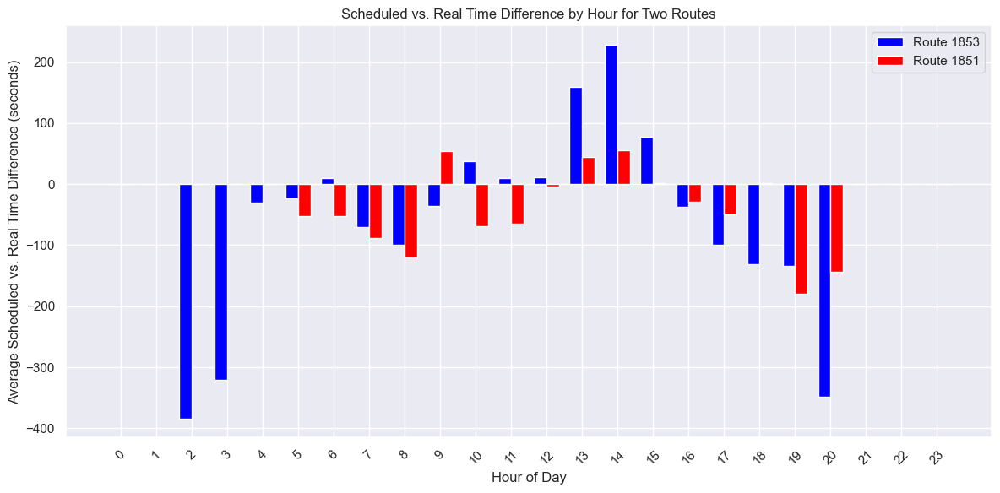

In [166]:
city = data['gtfs_stop__city'].value_counts().idxmax()

route_id = data[data['gtfs_stop__city'] == city]['siri_ride__siri_route_id'].value_counts().idxmax()
route_id_2 = data[data['gtfs_stop__city'] == city]['siri_ride__siri_route_id'].value_counts().index[1]

data_route_1 = data[data['siri_ride__siri_route_id'] == route_id]
data_route_2 = data[data['siri_ride__siri_route_id'] == route_id_2]

all_hours = np.arange(24) 

agg_route_1 = data_route_1.groupby(data_route_1['date_time'].dt.hour)['scheduled_vs_real_time_difference_seconds'].mean().reindex(all_hours, fill_value=0).reset_index()
agg_route_2 = data_route_2.groupby(data_route_2['date_time'].dt.hour)['scheduled_vs_real_time_difference_seconds'].mean().reindex(all_hours, fill_value=0).reset_index()

fig, ax = plt.subplots(figsize=(12, 6))

positions = np.arange(len(all_hours))
width = 0.35

plt.bar(positions - width/2, agg_route_1['scheduled_vs_real_time_difference_seconds'], width, label=f'Route {route_id}', color='blue')
plt.bar(positions + width/2, agg_route_2['scheduled_vs_real_time_difference_seconds'], width, label=f'Route {route_id_2}', color='red')

ax.set_xlabel('Hour of Day')
ax.set_ylabel('Average Scheduled vs. Real Time Difference (seconds)')
ax.set_title('Scheduled vs. Real Time Difference by Hour for Two Routes')
ax.set_xticks(positions)
ax.set_xticklabels(all_hours, rotation=45)
ax.legend()

plt.tight_layout()
plt.show()

### Exploring Trends in Weather
Due to the fact that the weather can have a significant impact on the traffic, we will explore the data to see if we can find any trends in the days with different weather conditions.
The Data we use is taken from the https://ims.gov.il/he/data_gov and holds the information about if the day was rainy or not.
Because there was no rain in the training set, this feature will have zero impact on the model.


In [96]:
weather_df = pd.read_csv("one_file_rain.csv")
weather_df['תאריך'] = pd.to_datetime(weather_df['תאריך'], format='%d/%m/%Y')
weather_df = weather_df[(weather_df['תאריך'] >= '2022-01-01') & (weather_df['תאריך'] <= '2022-12-31')]
weather_df['rain'] = weather_df['תאריך'].apply(lambda x: 1 if pd.notnull(x) else 0)
fig = px.histogram(weather_df, x=weather_df['תאריך'].dt.month, y='rain', title='Rainy Days Monthly View')
fig.show()


### Exploring Trends in Sequence
We want to see if the time difference between the scheduled and the actual arrival time is different in different sequences of stops.
Because the transportation vehicles starts from the first stop and ends in the last stop, we expect to see a difference in the time difference between the
scheduled and the actual arrival time in different sequences of stops.

In [130]:
route_id = data['siri_ride__siri_route_id'].value_counts().idxmax()
data_for_violin_plot = data[data['siri_ride__siri_route_id'] == route_id]
fig = px.box(data_for_violin_plot, x='gtfs_ride_stop__stop_sequence', y='scheduled_vs_real_time_difference_seconds', title='Scheduled vs. Real Time Difference')
fig.show()

route_id = data['siri_ride__siri_route_id'].value_counts().index[1]
data_for_violin_plot = data[data['siri_ride__siri_route_id'] == route_id]
fig = px.box(data_for_violin_plot, x='gtfs_ride_stop__stop_sequence', y='scheduled_vs_real_time_difference_seconds', title='Scheduled vs. Real Time Difference')
fig.show()


As we can see, the time difference between the scheduled and the actual arrival time is different in different sequences of stops
is different between routes, but within the same route, the time difference can show a pattern.
This is an important feature in our model, so it will know to predict more accurate the time difference in different sequences of stops.


# Data Preprocessing
Due to the fact the in most of the holidays the public transportation is not working, we will focus on the days before and after the holidays.
We will create a new column called "is_holiday" which will be a boolean column that will indicate if the day is a holiday or not.


### FeatureCreator - finalized feature creation

# Final sets creation

# Models trainings

In this section we will train our models and evaluate them.

In [67]:
Models = [] # TODO

# Models evaluation and comparison

In [68]:
# TODO

# Summary and conclusions

In [69]:
# TODO